In [1]:
import os
import re
import pandas as pd
import spacy

In [2]:
path = 'C:/Users/kseht/Desktop/UH Spring 2022/Advance NLP/Project/Dataset/Defoe/Defoe'

In [3]:
os.chdir(path)

In [4]:
import string

In [5]:
text_list = []
file_name = []

for file in os.listdir():
    f= open(file, errors = "ignore")
#     print(f.read())
#     print('File name is : ', file)
    text = f.read().replace('\n', ' ')
    text = text.replace('\t',' ')
    text = text.replace('   ', ' ')
    text = text.replace('  ', ' ')
    text = text.replace('[', '')
    text = text.replace(']', '')
    text = text.replace("'", "")
    text = text.replace(".nf", "")
    text = text.replace("!\"#$%&()*+-./:;<=>?@[\]^_`{|}~\n", '')
    text = text.replace('.”', '”.').replace('."', '".').replace('?”', '”?').replace('!”', '”!')
    text = text.replace('--', ' ').replace('. . .', '').replace('_', '')
    #removing numbers
    text = re.sub('\d+', '',text)
    # removing the bullets
    text = re.sub('[(\s][0-9a-zA-Z][.)]\s+|[(\s][ivxIVX]+[.)]\s+', ' ', text)
    #removing all the URL from the text
    text = re.sub('(www|http)\S+', '',text)
    # removing the special characters
    text = re.sub('(å¼«¥ª°©ð±§µæ¹¢³¿®ä£)\S+','', text)
#     text = re.sub("[\<103D-Legio-5M The Memorial Exami¹d\>]+", '', text) 
    text = re.sub("#\w+", '', text)
#     text = re.sub("[.nf]", '', text)
    #extracting symbols and characters
    text=re.sub(r'@\w+',"",text)
    text=re.sub(r'#\w+',"",text) 
    text=re.sub(r'\w+:\/{2}[\d\w-]+(\.[\d\w-]+)*(?:(?:\/[^\s/]*))*', '', text) 
    punctuation = r"""!"#$%&'()*+,-./:;<=>?@[\]^_`{|}~"""

#     text=re.sub('[^A-Za-z\s]+',"", text)
#     text = text.lower()
#     text = text.split()
#     print(text)
#     print('File name is : ', file)

    # Removed the sentences having length less then 5
    #sentences = [sent for sent in sentences if len(sent) >= 5]
    #text_list.append(sentences)
    text=text.lower()
    text_list.append(text)
    file_name.append(file)

print(text_list)
print(file_name)


[' that no age can parallel the moderation of the present government, the contempt of snarling enemies, their disregard of slander and intolerable insolence, are testimonies beyond exception. the daily insults of a party, which the government may, and which some think they ought to resent, are most unaccountable. the loose the hot men of this party give to their tongues, even in the most sacred place the church, the sacred office of the pulpit; and their common, discourse is such, as no government but this, would ever bear with; a clear and apparent proof that the queen and the ministry, act by those principles of temper and moderation, that they at the fame time perswade the nation to. but, as if the party were resolved to try the extent of royal patience, and see, how long the queen may be insulted; and these the government ridicul¹d before her majesty can be provok¹d to shew her just resentment such sfage calls for. we have now publish¹d a pamphlet, entituled, the memorial of the ch

In [6]:
data = {'File Name' : file_name,
       'Text' : text_list}
test_df = pd.DataFrame(data)
test_df

,File Name,Text
0,103D,that no age can parallel the moderation of th...
1,112D,remarks on the bill to prevent frauds commit...
2,113D,remark on the letter of the author of the st...
3,115D,"this satyr had never been publishd, tho some..."
4,156D,advice to the electors of great britain; occ...
...,...,...
143,87D,cassandra answerd. when a man is big with h...
144,88D,"to the knights, cttzzens and burgesses in pa..."
145,92D,the writings of daniel defoe persecution ana...
146,95D,blackwell-hall a hint to the blackwell-hal...


In [7]:
import nltk
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
# function to remove stopwords
def remove_stopwords(text):
    textArr = text.split(' ')
    rem_text = " ".join([i for i in textArr if i not in stop_words])
    return rem_text

# remove stopwords from the text
test_df['Text']=test_df['Text'].apply(remove_stopwords)

In [8]:
text_list=test_df['Text'].tolist()
print(text_list)
#tokenized_reviews = lemmatization(text_list)
#print(tokenized_reviews[1])

[' age parallel moderation present government, contempt snarling enemies, disregard slander intolerable insolence, testimonies beyond exception. daily insults party, government may, think ought resent, unaccountable. loose hot men party give tongues, even sacred place church, sacred office pulpit; common, discourse such, government this, would ever bear with; clear apparent proof queen ministry, act principles temper moderation, fame time perswade nation to. but, party resolved try extent royal patience, see, long queen may insulted; government ridicul¹d majesty provok¹d shew resentment sfage calls for. publish¹d pamphlet, entituled, memorial church england. humbly offered confederation true lovers church constitution. present reader heads tract, full words, full horrible suggestions, barbarous treatment, queen, ministry, dissenters, would answer paragraph paragraph, thing significant part reducceable heads, shatt whole, thing piece, designs party, express¹d different manner. whole boo

In [9]:
# Lemmatization of the text 
# Considering lematization over stemming 

In [10]:
from nltk.stem import WordNetLemmatizer
wnl = WordNetLemmatizer()
words = text_list
for w in words: 
    print(w, " : ", wnl.lemmatize(w))

 age parallel moderation present government, contempt snarling enemies, disregard slander intolerable insolence, testimonies beyond exception. daily insults party, government may, think ought resent, unaccountable. loose hot men party give tongues, even sacred place church, sacred office pulpit; common, discourse such, government this, would ever bear with; clear apparent proof queen ministry, act principles temper moderation, fame time perswade nation to. but, party resolved try extent royal patience, see, long queen may insulted; government ridicul¹d majesty provok¹d shew resentment sfage calls for. publish¹d pamphlet, entituled, memorial church england. humbly offered confederation true lovers church constitution. present reader heads tract, full words, full horrible suggestions, barbarous treatment, queen, ministry, dissenters, would answer paragraph paragraph, thing significant part reducceable heads, shatt whole, thing piece, designs party, express¹d different manner. whole book 

In [11]:
import gensim
from gensim.utils import simple_preprocess
def sent_to_words(sentences):
    for sentence in sentences:
        # deacc=True removes punctuations
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))
def remove_stopwords(texts):
    return [[word for word in simple_preprocess(str(doc)) 
             if word not in stop_words] for doc in texts]

In [12]:
data_words = list(sent_to_words(words))
print(data_words)

[['age', 'parallel', 'moderation', 'present', 'government', 'contempt', 'snarling', 'enemies', 'disregard', 'slander', 'intolerable', 'insolence', 'testimonies', 'beyond', 'exception', 'daily', 'insults', 'party', 'government', 'may', 'think', 'ought', 'resent', 'unaccountable', 'loose', 'hot', 'men', 'party', 'give', 'tongues', 'even', 'sacred', 'place', 'church', 'sacred', 'office', 'pulpit', 'common', 'discourse', 'such', 'government', 'this', 'would', 'ever', 'bear', 'with', 'clear', 'apparent', 'proof', 'queen', 'ministry', 'act', 'principles', 'temper', 'moderation', 'fame', 'time', 'perswade', 'nation', 'to', 'but', 'party', 'resolved', 'try', 'extent', 'royal', 'patience', 'see', 'long', 'queen', 'may', 'insulted', 'government', 'ridicul¹d', 'majesty', 'provok¹d', 'shew', 'resentment', 'sfage', 'calls', 'for', 'publish¹d', 'pamphlet', 'entituled', 'memorial', 'church', 'england', 'humbly', 'offered', 'confederation', 'true', 'lovers', 'church', 'constitution', 'present', 'reade

In [13]:
import gensim.corpora as corpora

# Create Dictionary
id2word = corpora.Dictionary(data_words)

# Create Corpus
texts = data_words

# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]

# View
print(corpus[:1][0][:30])

[(0, 1), (1, 1), (2, 1), (3, 1), (4, 2), (5, 1), (6, 1), (7, 1), (8, 1), (9, 3), (10, 2), (11, 1), (12, 1), (13, 1), (14, 1), (15, 1), (16, 1), (17, 1), (18, 1), (19, 4), (20, 1), (21, 1), (22, 1), (23, 1), (24, 1), (25, 1), (26, 2), (27, 1), (28, 1), (29, 2)]


In [14]:
from pprint import pprint

# number of topics
num_topics = 10

# Build LDA model
lda_model = gensim.models.LdaMulticore(corpus=corpus,
                                       id2word=id2word,
                                       num_topics=num_topics)

# Print the Keyword in the 10 topics
pprint(lda_model.print_topics())
doc_lda = lda_model[corpus]

[(0,
  '0.008*"upon" + 0.005*"it" + 0.005*"may" + 0.005*"king" + 0.005*"trade" + '
  '0.005*"would" + 0.004*"people" + 0.004*"men" + 0.004*"say" + 0.004*"us"'),
 (1,
  '0.009*"upon" + 0.006*"it" + 0.005*"men" + 0.005*"would" + 0.005*"king" + '
  '0.005*"great" + 0.005*"people" + 0.004*"may" + 0.004*"them" + 0.004*"said"'),
 (2,
  '0.008*"upon" + 0.008*"it" + 0.007*"may" + 0.006*"them" + 0.006*"would" + '
  '0.005*"one" + 0.005*"us" + 0.005*"people" + 0.004*"men" + 0.004*"time"'),
 (3,
  '0.009*"upon" + 0.007*"it" + 0.006*"may" + 0.005*"would" + 0.004*"them" + '
  '0.004*"people" + 0.004*"one" + 0.004*"time" + 0.004*"us" + 0.004*"shall"'),
 (4,
  '0.007*"would" + 0.007*"upon" + 0.005*"it" + 0.005*"may" + 0.005*"great" + '
  '0.005*"people" + 0.004*"men" + 0.004*"them" + 0.004*"king" + 0.004*"one"'),
 (5,
  '0.008*"upon" + 0.006*"may" + 0.005*"would" + 0.005*"one" + 0.005*"them" + '
  '0.005*"it" + 0.005*"us" + 0.004*"made" + 0.004*"men" + 0.004*"say"'),
 (6,
  '0.007*"upon" + 0.005*"wou

In [19]:
from gensim.models import CoherenceModel
# Compute Perplexity
print('\nPerplexity: ', lda_model.log_perplexity(corpus))  
# a measure of how good the model is. lower the better.

# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=lda_model, texts=data_words, dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -8.81985553776908

Coherence Score:  0.21967913243933848


In [20]:
from gensim.models import CoherenceModel

def compute_coherence_values(dictionary, data, corpus, limit, start, step):
    coherence_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        model = lda_model = gensim.models.ldamodel.LdaModel(corpus = corpus,
                                           id2word = dictionary,
                                           num_topics = num_topics,
                                           random_state = 10)
        model_list.append(model)
        coherencemodel = CoherenceModel(model = model,
                                        texts = data, 
                                        dictionary = dictionary,
                                        coherence = 'c_v')
        coherence_values.append(coherencemodel.get_coherence())

    return model_list, coherence_values

In [21]:
start = 10; limit = 30; step = 2

model_list, coherence_values = compute_coherence_values(dictionary = id2word, 
                                                        data = data_words, corpus = corpus, 
                                                        start = start, limit = limit,
                                                        step = step)

In [22]:
import matplotlib.pyplot as plt
%matplotlib inline

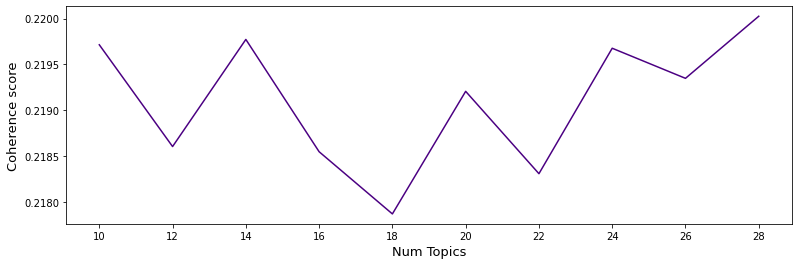

In [23]:
x = range(start, limit, step)
plt.figure(figsize = (13, 4))
plt.plot(x, coherence_values, color = 'indigo')
plt.xlabel("Num Topics", fontsize = 13)
plt.ylabel("Coherence score", fontsize = 13)
plt.xticks(x)
plt.show()

In [24]:
for m, cv in zip(x, coherence_values):
    print("Num Topics =", m, " has Coherence Value of", round(cv, 3))

Num Topics = 10  has Coherence Value of 0.22
Num Topics = 12  has Coherence Value of 0.219
Num Topics = 14  has Coherence Value of 0.22
Num Topics = 16  has Coherence Value of 0.219
Num Topics = 18  has Coherence Value of 0.218
Num Topics = 20  has Coherence Value of 0.219
Num Topics = 22  has Coherence Value of 0.218
Num Topics = 24  has Coherence Value of 0.22
Num Topics = 26  has Coherence Value of 0.219
Num Topics = 28  has Coherence Value of 0.22
